In [680]:
import numpy as np
import sympy as sp
import matplotlib.pyplot as plt
from sympy.utilities import lambdify
from matplotlib.animation import FuncAnimation
from IPython.display import  HTML

In [681]:
x = sp.Symbol('x',real=True)
k = sp.Symbol('k',real=True, positive=True)
a = sp.Symbol('a',real=True)
n = sp.Symbol('n',integer=True, nonzero =True)
m = sp.Symbol('m',integer=True, positive=True)
h = sp.Symbol('hbar',integer=True, positive=True)
t = sp.Symbol('t',integer=True, positive=True)
psi = sp.Function('\psi')

x, k, psi(x), a, n, m , h, t

(x, k, \psi(x), a, n, m, hbar, t)

In [682]:
(x**2 + sp.sin(x)).diff(x)

2*x + cos(x)

In [683]:
psi(x).diff(x, x)

Derivative(\psi(x), (x, 2))

In [684]:
-k**2*psi(x)

-k**2*\psi(x)

In [685]:
eq = sp.Eq(psi(x).diff(x, x), -k**2 * psi(x))
eq

Eq(Derivative(\psi(x), (x, 2)), -k**2*\psi(x))

In [686]:
sol = sp.dsolve(eq,psi(x), ics = {psi(0):0})
sol

Eq(\psi(x), C1*sin(k*x))

In [687]:
# sol = sp.dsolve(eq,psi(x), ics = {psi(0):0, psi(a):0,})
# sol

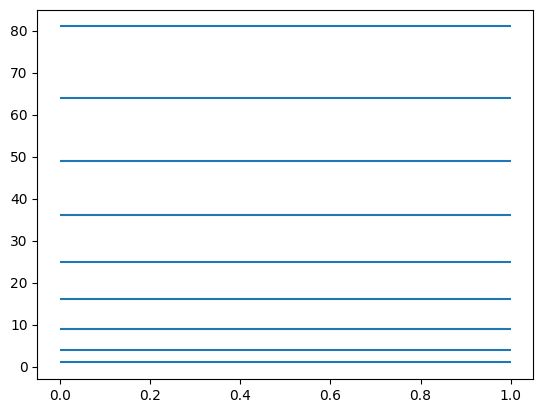

In [688]:
plt.hlines(np.arange(1,10)**2,0,1)

In [689]:
sp.pi.evalf(100)

3.141592653589793238462643383279502884197169399375105820974944592307816406286208998628034825342117068

In [690]:
sol = sol.subs(k, n * sp.pi / a)
sol

Eq(\psi(x), C1*sin(pi*n*x/a))

In [691]:
sol.lhs

\psi(x)

In [692]:
sol.rhs**2

C1**2*sin(pi*n*x/a)**2

In [693]:
sp.integrate(sol.rhs**2,(x, 0, a))

C1**2*a/2

In [694]:
sp.Symbol('C1')

C1

In [695]:
sol = sol.subs(sp.Symbol('C1'), sp.sqrt(2/a))
sol

Eq(\psi(x), sqrt(2)*sqrt(1/a)*sin(pi*n*x/a))

In [696]:
E= n**2 * sp.pi**2 * h**2 / (2 * m * a**2)
E

pi**2*hbar**2*n**2/(2*a**2*m)

In [697]:
phi = sp.exp(-sp.I *E *t / h)
phi

exp(-I*pi**2*hbar*n**2*t/(2*a**2*m))

In [698]:
Psi = sol.rhs*phi
Psi

sqrt(2)*sqrt(1/a)*exp(-I*pi**2*hbar*n**2*t/(2*a**2*m))*sin(pi*n*x/a)

In [699]:
Psi.subs({a:1, h:1, m:1})

sqrt(2)*exp(-I*pi**2*n**2*t/2)*sin(pi*n*x)

In [700]:
Psif = lambdify((x, t, n), Psi.subs({m: 1, a: 1, h: 1}))

In [701]:
Psif(0.3,0,1), Psif(0.3,0,1).real, Psif(0.3,0,1).imag

((1.1441228056353687+0j), 1.1441228056353687, 0.0)

In [702]:
xs= np.linspace(0,1,10)
Psif(xs,0.2,1)

array([0.00000000e+00+0.00000000e+00j, 2.66623438e-01-4.03568456e-01j,
       5.01088155e-01-7.58460601e-01j, 6.75114245e-01-1.02187120e+00j,
       7.67711594e-01-1.16202906e+00j, 7.67711594e-01-1.16202906e+00j,
       6.75114245e-01-1.02187120e+00j, 5.01088155e-01-7.58460601e-01j,
       2.66623438e-01-4.03568456e-01j, 9.54679269e-17-1.44502839e-16j])

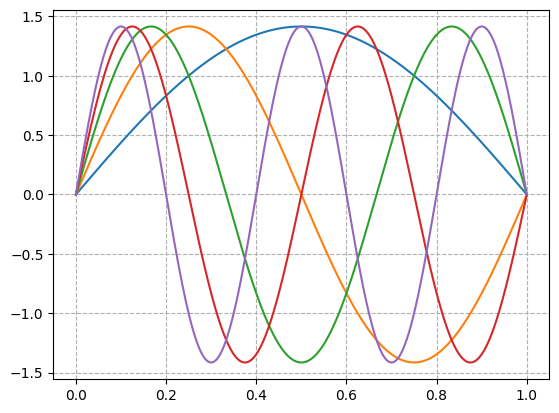

In [703]:
xs=np.linspace(0,1,1000)
plt.grid(linestyle = "--")

plt.plot(xs, Psif(xs, 0, 1).real)

plt.plot(xs, Psif(xs, 0, 2).real)

plt.plot(xs, Psif(xs, 0, 3).real)

plt.plot(xs, Psif(xs, 0, 4).real)

plt.plot(xs, Psif(xs, 0, 5).real)

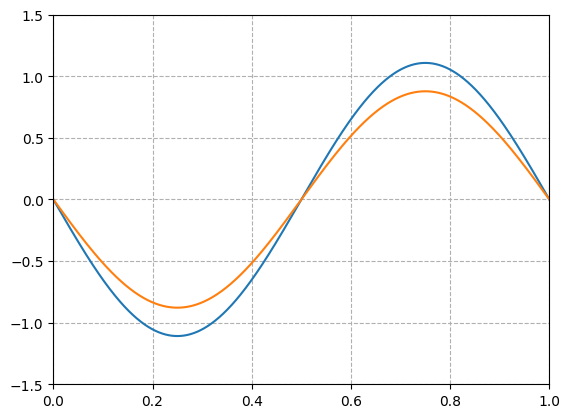

In [704]:
n=2
xs = np.linspace(0,1,1000)
fig = plt.figure()
plt.grid(linestyle="--")
plot1, = plt.plot([],[])
plot2, = plt.plot([],[])
plt.xlim(0,1)
plt.ylim(-1.5,1.5)
plt.close

dt = 0.01

def frame(i):
    t=i*dt
    ys =Psif(xs, t, n)

    plot1.set_data(xs, ys.real)
    plot2.set_data(xs, ys.imag)

    return plot1, plot2

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())

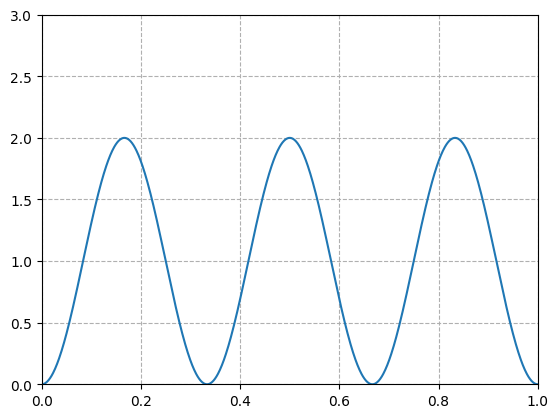

In [705]:
n=3
xs = np.linspace(0,1,1000)
fig = plt.figure()
plt.grid(linestyle="--")
plot1, = plt.plot([],[])
plt.xlim(0,1)
plt.ylim(0,3)
plt.close

dt = 0.01

def frame(i):
    t=i*dt
    ys =Psif(xs, t, n)
    ys1 =np.abs(ys)**2

    plot1.set_data(xs, ys1)

    return plot1,

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())

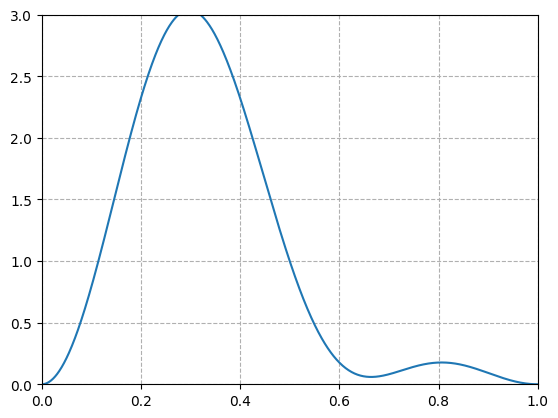

In [706]:

xs = np.linspace(0,1,1000)
fig = plt.figure()
plt.grid(linestyle="--")
plot1, = plt.plot([],[])
plt.xlim(0,1)
plt.ylim(0,3)
plt.close

dt = 0.01

def frame(i):
    t=i*dt
    ys = ( Psif(xs, t, 1) + Psif(xs,t,2))/(np.sqrt(2))
    ys1 =np.abs(ys)**2

    plot1.set_data(xs, ys1)

    return plot1,

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())

In [707]:
sol

Eq(\psi(x), sqrt(2)*sqrt(1/a)*sin(pi*n*x/a))

In [708]:
sol.rhs * x * sol.rhs

2*x*sin(pi*n*x/a)**2/a

In [709]:
sp.integrate(sol.rhs * x * sol.rhs, (x, 0, a))

a/2

In [711]:
sp.integrate(sol.rhs * x**2 * sol.rhs, (x, 0, a)).simplify()

a**2/3 - a**2/(2*pi**2*n**2)

$$<p>=?$$
$$<p^2>=?$$

In [729]:
p = sp.integrate(sol.rhs * sol.rhs.diff(x), (x,0,a)).simplify()
p

0

In [728]:
p2 =  -h**2 * sp.integrate(sol.rhs * sol.rhs.diff(x, 2), (x,0,a)).simplify()
p2

pi**2*hbar**2*n**2/a**2